# Hourly Time Series Forecasting using Facebook's Prophet

In this notebook we will use facebook's prophet package to forecast hourly energy use. 

1. Import useful libraries

In [94]:
# !pip install -q fsspec
# !pip install -q s3fs

In [133]:
import numpy as np
import pandas as pd
import datetime as dt
from prophet import Prophet
from sklearn.metrics import mean_squared_error, mean_absolute_error

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
# setting Jedha color palette as default
pio.templates["jedha"] = go.layout.Template(
    layout_colorway=["#4B9AC7", "#4BE8E0", "#9DD4F3", "#97FBF6", "#2A7FAF", "#23B1AB", "#0E3449", "#015955"]
)
pio.templates.default = "jedha"
# pio.renderers.default = "svg" # to be replaced by "iframe" if working on colab

# Data
The data we will be using is hourly power consumption data from PJM. Energy consumtion has some unique charachteristics. It will be interesting to see how prophet picks them up.

Pulling the `PJM East` which has data from 2002-2018 for the entire east region.

2. import the data thanks to the following link : ```https://full-stack-bigdata-datasets.s3.eu-west-3.amazonaws.com/Machine+Learning+Supervis%C3%A9/time_series/PJME_hourly.csv`` make sure to use the arguments ```index_col=[0], parse_dates=[0]``` and remove all dates previous to january the first 2008

In [96]:
pjm_east = pd.read_csv('https://full-stack-bigdata-datasets.s3.eu-west-3.amazonaws.com/Machine+Learning+Supervis%C3%A9/time_series/PJME_hourly.csv',
                   index_col=[0], parse_dates=[0]) 

start_date = '01-Jan-2008'
pjm_east = pjm_east.loc[pjm_east.index >= start_date]
pjm_east = pjm_east[~pjm_east.index.duplicated()] # Remove duplicate indices
pjm_east.head()

,PJME_MW
Datetime,
2008-01-01 00:00:00,30998.0
2008-12-31 01:00:00,28937.0
2008-12-31 02:00:00,27714.0
2008-12-31 03:00:00,27120.0
2008-12-31 04:00:00,26995.0


3. Plot the time series

In [97]:
fig = px.line(x=pjm_east.index, y = pjm_east["PJME_MW"], width=800, height=500)
fig.show()

# EDA

4. Create this collection of new variables :
* ```date``` equal to the index
* ```hour``` equal to the hour of the day
* ```dayofweek```
* ```quarter```
* ```month```
* ```year```
* ```dayofyear```
* ```dayofmonth```
* ```weekofyear```

Create an object X containing the above variables and y containing the time series

In [98]:
X = pjm_east.copy()
display(X)
print(X.columns)


,PJME_MW
Datetime,
2008-01-01 00:00:00,30998.0
2008-12-31 01:00:00,28937.0
2008-12-31 02:00:00,27714.0
2008-12-31 03:00:00,27120.0
2008-12-31 04:00:00,26995.0
...,...
2018-01-01 20:00:00,44284.0
2018-01-01 21:00:00,43751.0
2018-01-01 22:00:00,42402.0


Index(['PJME_MW'], dtype='object')


In [99]:
target = "PJME_MW"

X = pjm_east.copy()

X['date']       = X.index
X['hour']       = X['date'].dt.hour
X['dayofweek']  = X['date'].dt.dayofweek
X['quarter']    = X['date'].dt.quarter
X['month']      = X['date'].dt.month
X['year']       = X['date'].dt.year
X['dayofyear']  = X['date'].dt.dayofyear
X['dayofmonth'] = X['date'].dt.day
X['weekofyear'] = X['date'].dt.isocalendar().week

y = X["PJME_MW"]

X = X.drop(columns=["PJME_MW"])




In [100]:
X.head()


,date,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
Datetime,,,,,,,,,
2008-01-01 00:00:00,2008-01-01 00:00:00,0,1,1,1,2008,1,1,1
2008-12-31 01:00:00,2008-12-31 01:00:00,1,2,4,12,2008,366,31,1
2008-12-31 02:00:00,2008-12-31 02:00:00,2,2,4,12,2008,366,31,1
2008-12-31 03:00:00,2008-12-31 03:00:00,3,2,4,12,2008,366,31,1
2008-12-31 04:00:00,2008-12-31 04:00:00,4,2,4,12,2008,366,31,1


In [101]:
type(X)

pandas.core.frame.DataFrame

In [102]:
y.head()


Datetime
2008-01-01 00:00:00    30998.0
2008-12-31 01:00:00    28937.0
2008-12-31 02:00:00    27714.0
2008-12-31 03:00:00    27120.0
2008-12-31 04:00:00    26995.0
Name: PJME_MW, dtype: float64

In [103]:
type(y)

pandas.core.series.Series

5. Create an object features_and_target containing both and display the first few lines

In [104]:
features_and_target = pd.concat([X, y], axis=1)
features_and_target.head()


,date,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,PJME_MW
Datetime,,,,,,,,,,
2008-01-01 00:00:00,2008-01-01 00:00:00,0,1,1,1,2008,1,1,1,30998.0
2008-12-31 01:00:00,2008-12-31 01:00:00,1,2,4,12,2008,366,31,1,28937.0
2008-12-31 02:00:00,2008-12-31 02:00:00,2,2,4,12,2008,366,31,1,27714.0
2008-12-31 03:00:00,2008-12-31 03:00:00,3,2,4,12,2008,366,31,1,27120.0
2008-12-31 04:00:00,2008-12-31 04:00:00,4,2,4,12,2008,366,31,1,26995.0


In [105]:
features_and_target.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 92791 entries, 2008-01-01 00:00:00 to 2018-01-02 00:00:00
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   date        92791 non-null  datetime64[ns]
 1   hour        92791 non-null  int32         
 2   dayofweek   92791 non-null  int32         
 3   quarter     92791 non-null  int32         
 4   month       92791 non-null  int32         
 5   year        92791 non-null  int32         
 6   dayofyear   92791 non-null  int32         
 7   dayofmonth  92791 non-null  int32         
 8   weekofyear  92791 non-null  UInt32        
 9   PJME_MW     92791 non-null  float64       
dtypes: UInt32(1), datetime64[ns](1), float64(1), int32(7)
memory usage: 5.0 MB


## Plotting the Features to see trends

6. Plot the time series against hour, dayofweek, weekofyear, year


In [106]:
fig = px.scatter(features_and_target, x = 'hour', y = 'PJME_MW', width=800, height=500)
fig.show()


In [115]:
fig = px.scatter(features_and_target, x = 'dayofweek', y = 'PJME_MW',  color = 'hour', width=800, height=500) # , 
fig.show()


In [116]:
fig = px.scatter(features_and_target, x = 'weekofyear', y = 'PJME_MW', color = 'dayofweek', width=800, height=500) # , 
fig.show()


In [118]:
fig = px.scatter(features_and_target, x = 'year', y = 'PJME_MW', color = 'weekofyear', width=800, height=500) # , 
fig.show()

In [128]:
pjm_east.index

DatetimeIndex(['2008-01-01 00:00:00', '2008-12-31 01:00:00',
               '2008-12-31 02:00:00', '2008-12-31 03:00:00',
               '2008-12-31 04:00:00', '2008-12-31 05:00:00',
               '2008-12-31 06:00:00', '2008-12-31 07:00:00',
               '2008-12-31 08:00:00', '2008-12-31 09:00:00',
               ...
               '2018-01-01 15:00:00', '2018-01-01 16:00:00',
               '2018-01-01 17:00:00', '2018-01-01 18:00:00',
               '2018-01-01 19:00:00', '2018-01-01 20:00:00',
               '2018-01-01 21:00:00', '2018-01-01 22:00:00',
               '2018-01-01 23:00:00', '2018-01-02 00:00:00'],
              dtype='datetime64[ns]', name='Datetime', length=92791, freq=None)

# Train/Test Split
7. Cut off the data after 2015 to use as our validation set. We will train on earlier data.

In [129]:
# split = '01-Jan-2015'
split = "2015"

# split2 = dt.datetime.strptime(split)
# pd.to_datetime(split)


pjm_east_train  = pjm_east.loc[pjm_east.index < split].copy()
pjm_east_test   = pjm_east.loc[pjm_east.index >=  split].copy()

In [111]:
print(type(pjm_east_train.index))
print(type(pjm_east_train["PJME_MW"]))
print()
print(type(pjm_east_test.index))
print(type(pjm_east_test["PJME_MW"]))

<class 'pandas.core.indexes.datetimes.DatetimeIndex'>
<class 'pandas.core.series.Series'>

<class 'pandas.core.indexes.datetimes.DatetimeIndex'>
<class 'pandas.core.series.Series'>


8. plot the series with different colors for the train and test set to visualize the separation.

In [130]:
fig1 = px.line(x=pjm_east_train.index, y = pjm_east_train["PJME_MW"], width=800, height=500)
fig1.show()


In [131]:
fig2 = px.line(x=pjm_east_test.index, y = pjm_east_test["PJME_MW"], width=800, height=500)
fig2.show()

In [132]:
fig =         px.line(x=pjm_east_train.index, y = pjm_east_train["PJME_MW"], width=800, height=500)
fig.add_trace(px.line(x=pjm_east_test.index,  y = pjm_east_test["PJME_MW"],  width=800, height=500).data[0])
fig['data'][1]['line']['color']='red'
fig.show()


# Simple Prophet Model
9. In pjme_train rename the Datetime variable "ds" and PJME_MW "y" to fit into the Prophet framework

In [64]:
pjm_east_train = pjm_east_train.reset_index().rename(columns={'Datetime':'ds','PJME_MW':'y'})
pjm_east_train.head()

,ds,y
0,2008-01-01 00:00:00,30998.0
1,2008-12-31 01:00:00,28937.0
2,2008-12-31 02:00:00,27714.0
3,2008-12-31 03:00:00,27120.0
4,2008-12-31 04:00:00,26995.0


10. Create an instance of the Prophet model and fit it on the train data.

In [65]:
model = Prophet()
model.fit(pjm_east_train)

15:45:57 - cmdstanpy - INFO - Chain [1] start processing
15:46:26 - cmdstanpy - INFO - Chain [1] done processing


11. Make predictions with your trained default prophet model on the test set

In [66]:
pjm_east_test = pjm_east_test.reset_index().rename(columns={'Datetime':'ds'})
pjme_test_predictions = model.predict(df=pjm_east_test)

In [67]:
display(pjme_test_predictions)

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2015-01-01 01:00:00,30847.530101,25548.866530,34373.666810,30847.530101,30847.530101,-1085.861939,-1085.861939,-1085.861939,-4352.200273,...,1236.797152,1236.797152,1236.797152,2029.541182,2029.541182,2029.541182,0.0,0.0,0.0,29761.668162
1,2015-01-01 02:00:00,30847.410060,23874.228590,32417.509256,30847.410060,30847.410060,-2560.993242,-2560.993242,-2560.993242,-5821.746901,...,1228.656840,1228.656840,1228.656840,2032.096819,2032.096819,2032.096819,0.0,0.0,0.0,28286.416819
2,2015-01-01 03:00:00,30847.290020,23068.045275,31962.639479,30847.290020,30847.290020,-3416.669732,-3416.669732,-3416.669732,-6670.531615,...,1219.183695,1219.183695,1219.183695,2034.678188,2034.678188,2034.678188,0.0,0.0,0.0,27430.620288
3,2015-01-01 04:00:00,30847.169979,22870.177064,31743.796731,30847.169979,30847.169979,-3541.963614,-3541.963614,-3541.963614,-6787.735804,...,1208.486899,1208.486899,1208.486899,2037.285292,2037.285292,2037.285292,0.0,0.0,0.0,27305.206365
4,2015-01-01 05:00:00,30847.049938,23293.537068,32436.541954,30847.049938,30847.049938,-2851.010111,-2851.010111,-2851.010111,-6087.615747,...,1196.687502,1196.687502,1196.687502,2039.918133,2039.918133,2039.918133,0.0,0.0,0.0,27996.039827
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31431,2018-08-02 20:00:00,27074.052479,-64209.239538,136898.462198,-74243.405281,126777.275174,9300.376435,9300.376435,9300.376435,4413.015250,...,967.897891,967.897891,967.897891,3919.463294,3919.463294,3919.463294,0.0,0.0,0.0,36374.428915
31432,2018-08-02 21:00:00,27073.932439,-65549.698178,134310.055044,-74246.208650,126785.436869,8491.007114,8491.007114,8491.007114,3628.495032,...,951.983541,951.983541,951.983541,3910.528541,3910.528541,3910.528541,0.0,0.0,0.0,35564.939553
31433,2018-08-02 22:00:00,27073.812398,-66124.872357,134383.998596,-74249.012019,126793.598563,6856.436041,6856.436041,6856.436041,2019.054734,...,935.767827,935.767827,935.767827,3901.613479,3901.613479,3901.613479,0.0,0.0,0.0,33930.248439
31434,2018-08-02 23:00:00,27073.692358,-68715.398718,133735.783341,-74251.815388,126801.760258,4679.976951,4679.976951,4679.976951,-131.828618,...,919.087257,919.087257,919.087257,3892.718312,3892.718312,3892.718312,0.0,0.0,0.0,31753.669309


In [76]:
pjm_east_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31436 entries, 0 to 31435
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   ds       31436 non-null  datetime64[ns]
 1   PJME_MW  31436 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 491.3 KB


In [134]:
fig = px.line(pjme_test_predictions, x="ds", y = "yearly", width=800, height=500)
fig.show()


c:\Users\phili\anaconda3\envs\jedha\Lib\site-packages\prophet\plot.py:226: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

c:\Users\phili\anaconda3\envs\jedha\Lib\site-packages\prophet\plot.py:395: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

c:\Users\phili\anaconda3\envs\jedha\Lib\site-packages\prophet\plot.py:399: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

c:\Users\phili\anaconda3\envs\jedha\Lib\site-p

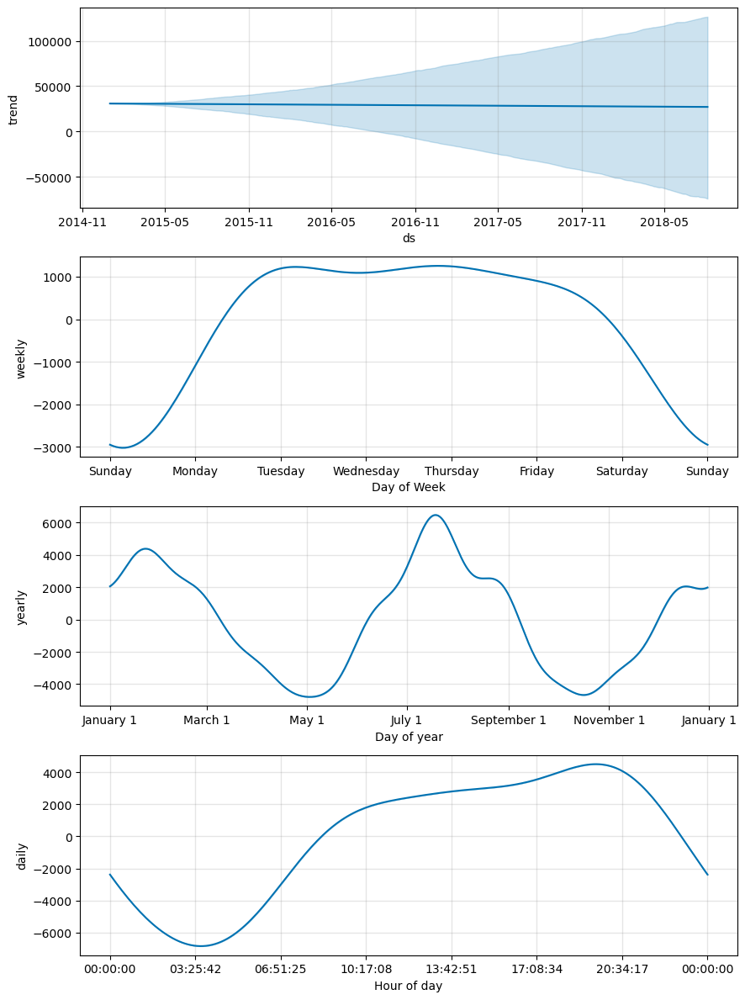

In [69]:
fig = model.plot_components(pjme_test_predictions)

13. Plot the trend, the yearly seasonnality, the weekly seasonnality, and the daily seasonnality.

# Compare Forecast to Actuals

14. Plot the forcasts against the actual values in the test set.

In [137]:
# fig = px.line(pjme_test_predictions, x="ds", y = "yhat", color ="yhat", color_discrete_map={'yhat': 'red'}, width=800, height=500)
# # fig.add_trace(px.line(x = pjm_east_test.index, y = pjm_east_test["PJME_MW"]).data[0])

# fig.show()



fig =         px.line(pjme_test_predictions,  x="ds", y = "yhat", width=800, height=500)
fig.add_trace(px.line(pjm_east_test,          x="ds", y = "PJME_MW").data[0])
fig['data'][1]['line']['color']='red'
fig.show()




ValueError: Value of 'x' is not the name of a column in 'data_frame'. Expected one of ['PJME_MW'] but received: ds

In [136]:
fig =         px.scatter(pjme_test_predictions,  x="ds", y = "yhat", width=800, height=500)
fig.add_trace(px.scatter(pjm_east_test,       x="ds", y = "PJME_MW").data[0])
fig['data'][1]['marker']['color']='red'
fig.show()


ValueError: Value of 'x' is not the name of a column in 'data_frame'. Expected one of ['PJME_MW'] but received: ds

# Look at first month of predictions

15. Compare in a graph predictions for the first month against reality.

In [79]:
type(pjm_east_test.index)

pandas.core.indexes.range.RangeIndex

In [135]:
mask = (pjm_east_test.index >= '01-01-2015') & (pjm_east_test.index < '02-01-2015')
fig = px.scatter(pjm_east_test, x = pjm_east_test.loc[mask,:].index, y = pjm_east_test.loc[mask,'PJME_MW'], width = 800, height=500)
# fig.add_trace(px.line(pjme_test_predictions  .loc[0:30*24,:], x="ds", y="yhat").data[0])
# fig['data'][1]['marker']['color']="#4BE8E0"
fig.show()

# Single Week of Predictions

16. plot the first week of data against the model's predictions

17. Calculate the MSE, the MAE and the MAPE (mean obsolute percentage error) for this model over the test dataset
$$MAPE = \frac{1}{n}\sum_{t=1}^{n}|\frac{Y_t - \hat{Y_t}}{Y_t}|$$

# Adding Holidays
Next we will see if adding holiday indicators will help the accuracy of the model. Prophet comes with a *Holiday Effects* parameter that can be provided to the model prior to training. 

We will use the built in pandas `USFederalHolidayCalendar` to pull the list of holidays

18. Create a test_holidays object containing the us federal holidays for the considered test period and an object train_holidays for the considered train period.

19. Create a DataFrame contaning all holidays over the observed period with a ds column with the dates and a holiday column with the holidays and convert ds column to datetime format.

20. Create an instance of the Prophet model with ```holidays = holiday_df``` the DataFrame we have just created, and train that model on the training set.

## Predict With Holidays

21. Make predictions for the test set with the holiday model

## Plot Holiday Effect

22. Plot the different components of the holiday model

# Error Metrics with Holidays Added
23. Calculate the MSE, MAE and MAPE for the holiday model on the test set.